In [1]:
from mmdet.apis import init_detector, inference_detector, show_result_pyplot
import mmcv

In [2]:
""" Baseline """
config_file = '/ws/external/configs/OA-DG/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes.py'
checkpoint_file = '/ws/data/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes/epoch_2.pth'
# build the model from a config file and a checkpoint file
model_baseline = init_detector(config_file, checkpoint_file, device='cuda:0')

""" OA-DG """
config_file = '/ws/external/configs/OA-DG/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes_oadg.py'
checkpoint_file = '/ws/data/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes_oadg/epoch_2.pth'

# build the model from a config file and a checkpoint file
model_oadg = init_detector(config_file, checkpoint_file, device='cuda:0')

def compare_results(img, title=''):
    if not title == '':
        title = f"({title})"
    img = f"demo_images/{img}"
    result = inference_detector(model_baseline, img)
    show_result_pyplot(model_baseline, img, result, title=f'baseline{title}')
    
    result = inference_detector(model_oadg, img)
    show_result_pyplot(model_oadg, img, result, title=f'OA-DG{title}')

load checkpoint from local path: /ws/data/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes/epoch_2.pth
load checkpoint from local path: /ws/data/cityscapes/faster_rcnn_r50_fpn_1x_cityscapes_oadg/epoch_2.pth


/ws/external/mmdet/datasets/utils.py:65: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


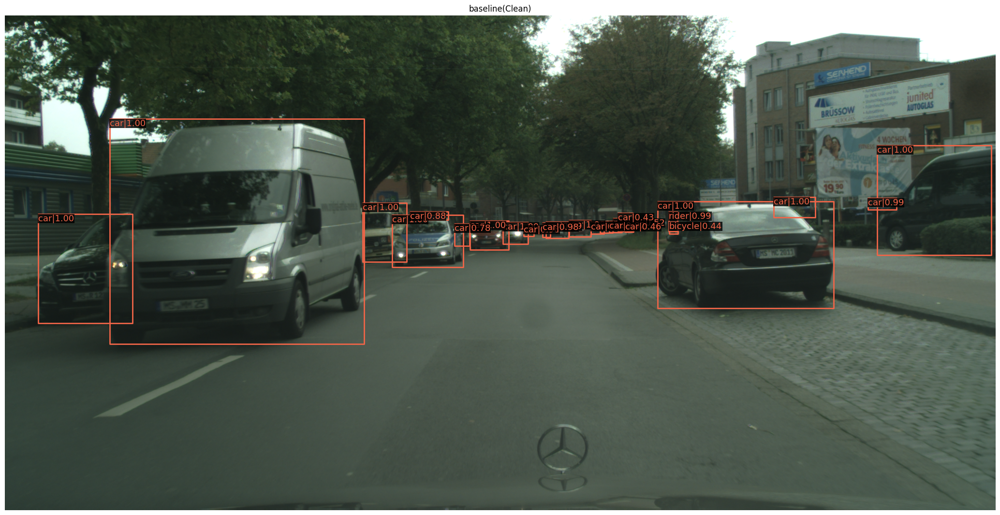

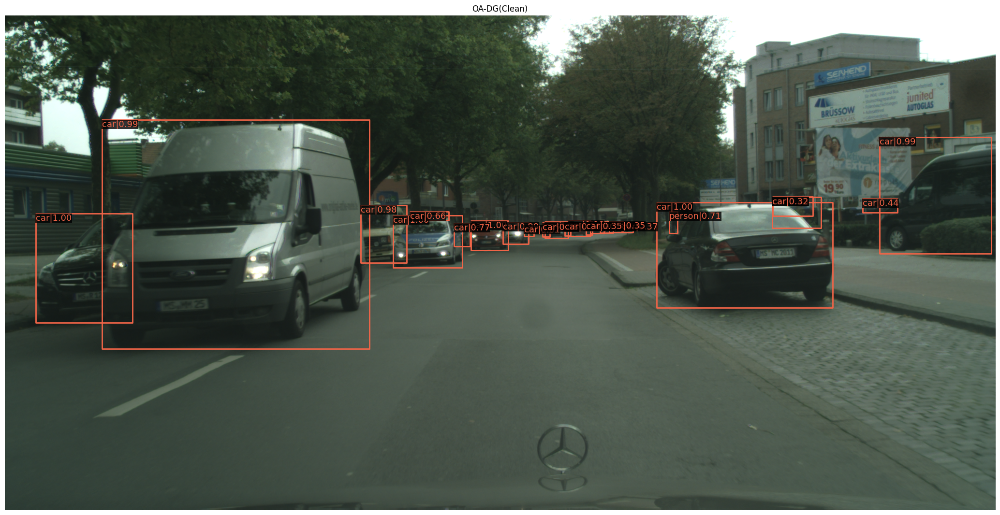

In [3]:
compare_results('demo_clean.png', 'Clean')

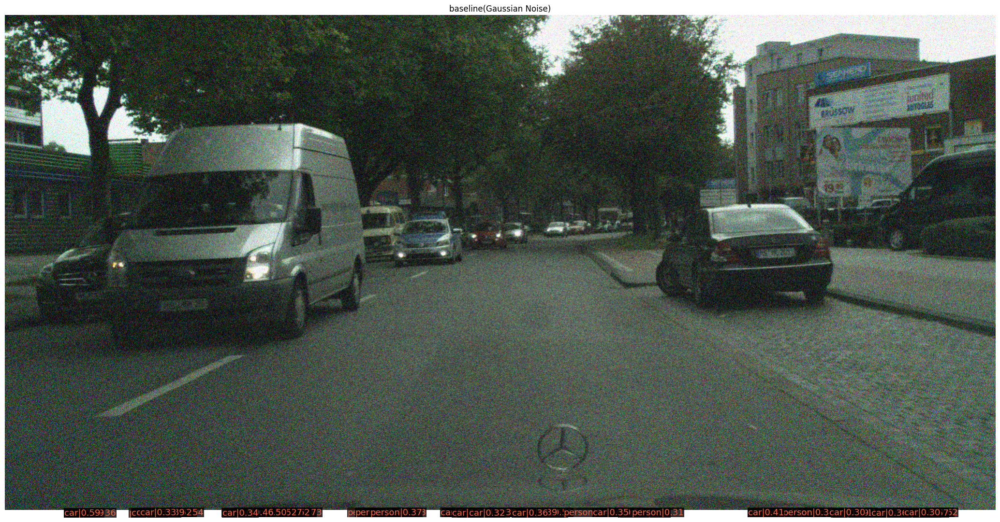

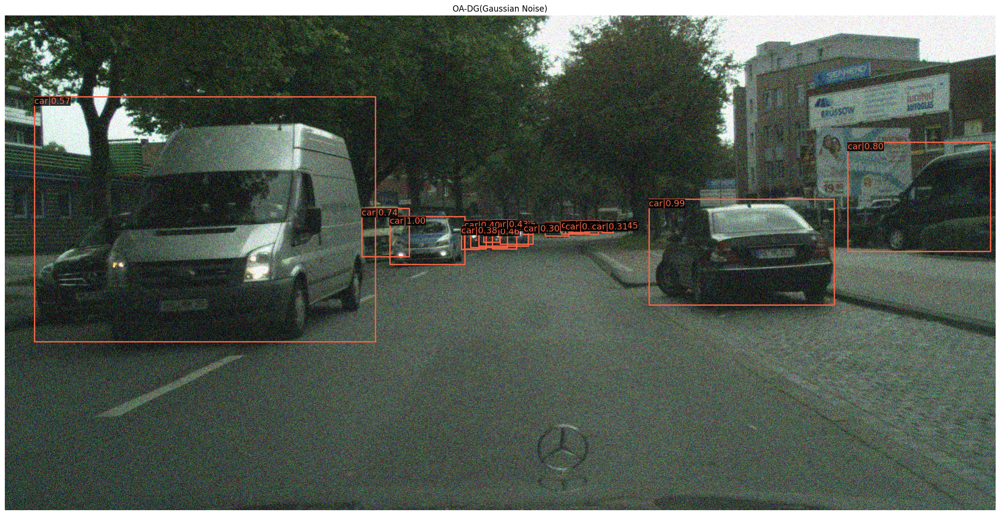

In [4]:
compare_results('demo_gaussian_noise.png', 'Gaussian Noise')

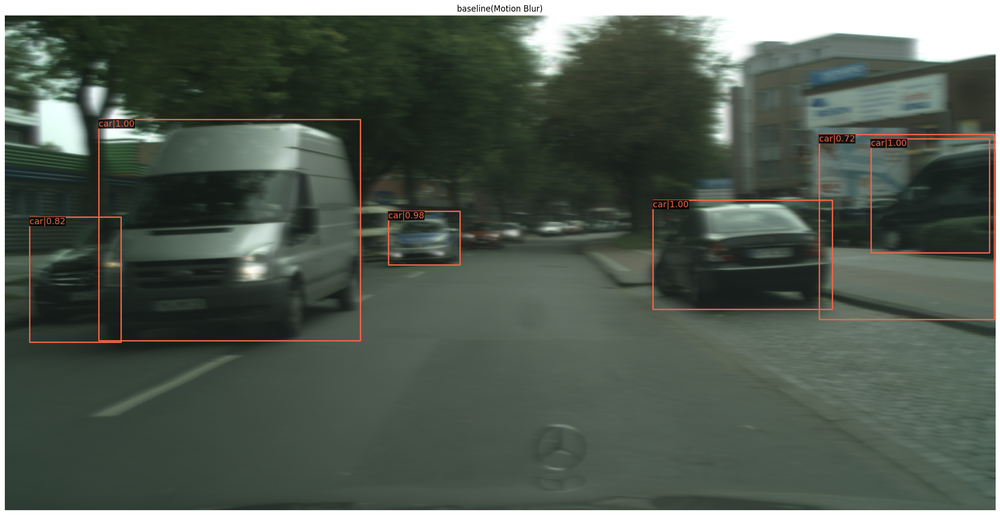

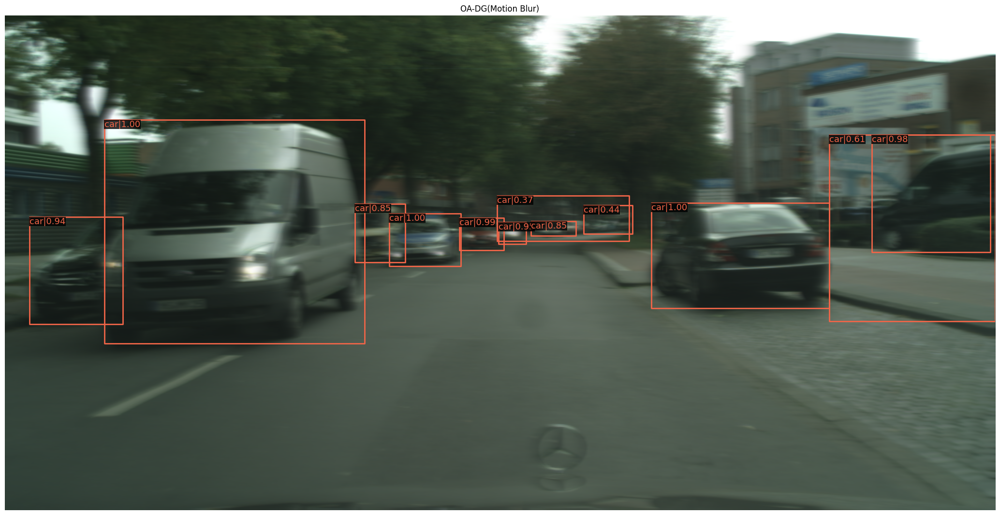

In [5]:
compare_results('demo_motion_blur.png', 'Motion Blur')

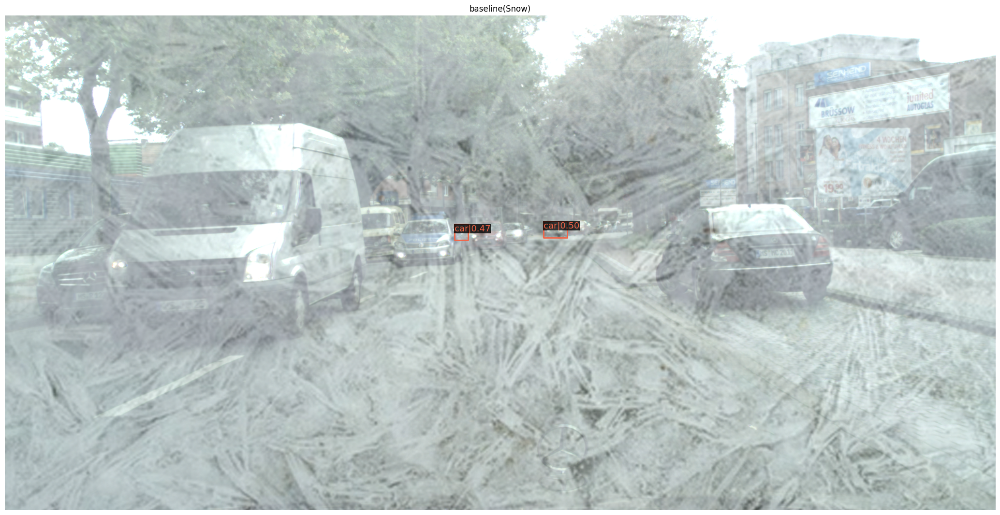

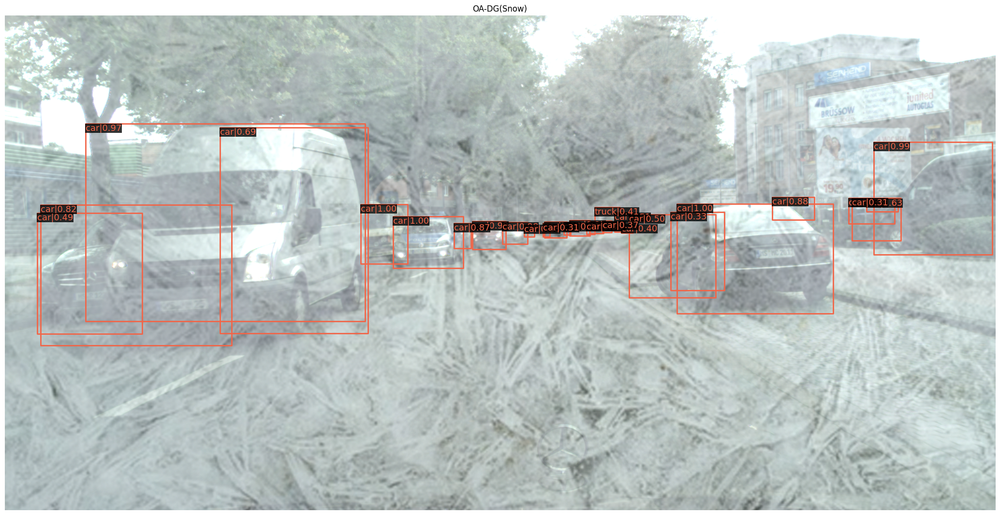

In [6]:
compare_results('demo_frost.png', 'Snow')

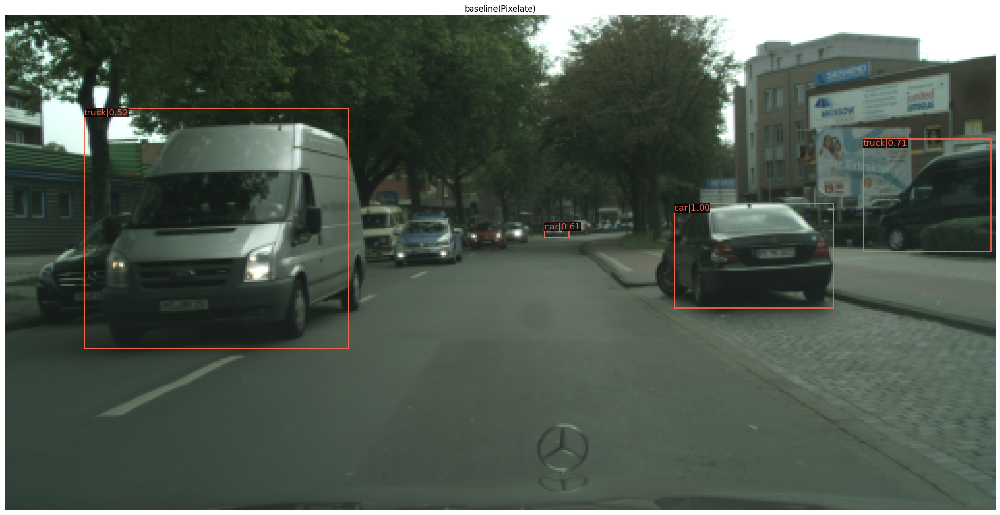

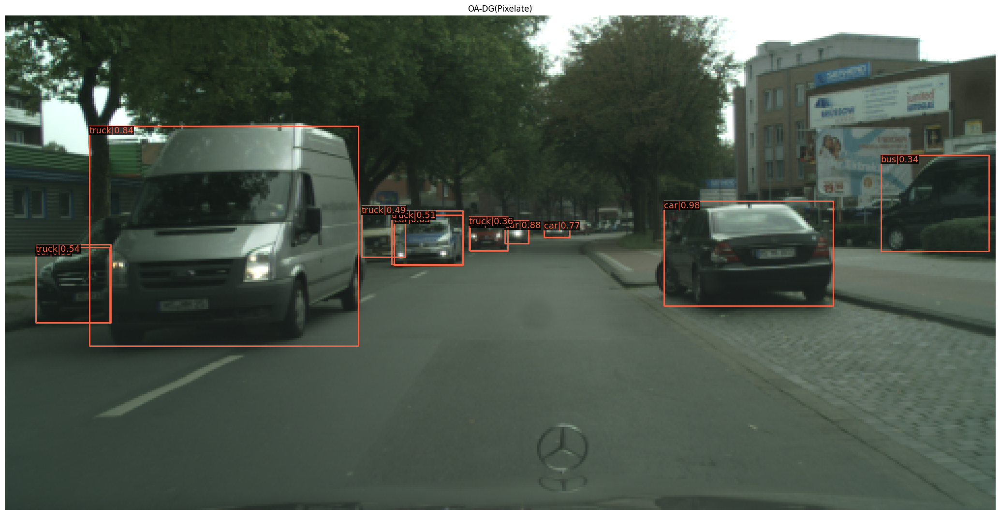

In [7]:
compare_results('demo_pixelate.png', 'Pixelate')